In [114]:
%matplotlib inline

In [8]:
import osmnx as ox
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets
import networkx as nx
from shapely.geometry import LineString

In [3]:
g = ox.graph_from_place('New York City, NY, USA',network_type = 'drive')
# g = ox.project_graph(g)

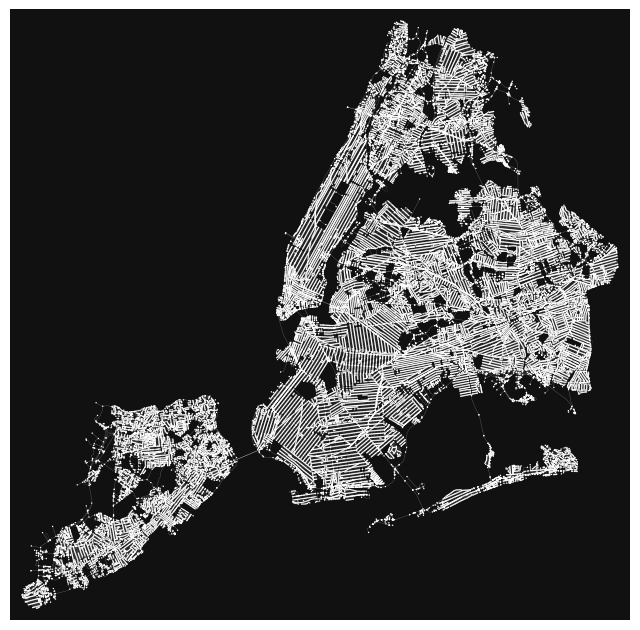

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [4]:
ox.plot_graph(g, node_size=1, node_color='w', edge_color='w', edge_linewidth=0.05)

def combine_taxi_dfs() -> pd.DataFrame:
    dfs = []
    for i in range(1,13):
        df = pd.read_csv(f'taxi/Yellow_Taxi_Trip_Data_{i}_2018.csv', infer_datetime_format=True)
        dfs.append(df.sample(50000))
    return dfs

combined = pd.concat(combine_taxi_dfs()).sort_values(by='tpep_pickup_datetime')
# combined_sample = combined.sample(n=50000)
# combined_sample

combined.to_csv('sampled_combined_taxi_2018_600k.csv')

In [5]:
d = pd.read_csv('sampled_combined_taxi_2018_600k.csv',parse_dates = ['tpep_pickup_datetime','tpep_dropoff_datetime'])

In [ ]:
plt.hist(d.tpep_dropoff_datetime);

In [6]:
d.sort_values(by='tpep_pickup_datetime')
d.rename(columns={'Unnamed: 0':'tripID'},inplace=True)
d.set_index('tripID')

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
tripID,,,,,,,,,,,,,,,,,
19061628,2,2018-01-01 01:00:03,2018-01-01 01:11:10,1,2.56,1,N,166,239,2,10.5,0.5,0.5,0.00,0.00,0.3,11.80
19061445,1,2018-01-01 01:00:38,2018-01-01 01:08:50,4,0.80,1,N,79,148,2,7.0,0.5,0.5,0.00,0.00,0.3,8.30
9350400,2,2018-01-01 01:00:53,2018-01-01 01:22:33,5,2.67,1,N,234,148,2,14.5,0.5,0.5,0.00,0.00,0.3,15.80
9350381,2,2018-01-01 01:00:56,2018-01-01 01:15:04,1,2.21,1,N,68,234,2,11.0,0.5,0.5,0.00,0.00,0.3,12.30
19061290,2,2018-01-01 01:01:05,2018-01-01 01:03:40,1,0.44,1,N,238,239,1,4.0,0.5,0.5,1.06,0.00,0.3,6.36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202215,2,2018-12-31 00:58:13,2018-12-31 01:23:11,2,6.15,1,N,237,173,2,22.5,0.5,0.5,0.00,0.00,0.3,23.80
142307,2,2018-12-31 12:58:18,2018-12-31 13:13:30,1,5.20,1,N,170,209,1,18.0,0.0,0.5,3.76,0.00,0.3,22.56
142263,2,2018-12-31 12:58:37,2018-12-31 13:30:14,6,18.45,2,N,132,90,2,52.0,0.0,0.5,0.00,5.76,0.3,58.56


In [214]:
nyc_gdf = gpd.read_file('NYC_Taxi_Zones.geojson')
nyc_gdf.set_index('objectid')

,shape_area,shape_leng,location_id,zone,borough,geometry
objectid,,,,,,
1,0.0007823067885,0.116357453189,1,Newark Airport,EWR,"MULTIPOLYGON (((-74.18445 40.69500, -74.18449 ..."
2,0.00486634037837,0.43346966679,2,Jamaica Bay,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ..."
3,0.000314414156821,0.0843411059012,3,Allerton/Pelham Gardens,Bronx,"MULTIPOLYGON (((-73.84793 40.87134, -73.84725 ..."
4,0.000111871946192,0.0435665270921,4,Alphabet City,Manhattan,"MULTIPOLYGON (((-73.97177 40.72582, -73.97179 ..."
5,0.000497957489363,0.0921464898574,5,Arden Heights,Staten Island,"MULTIPOLYGON (((-74.17422 40.56257, -74.17349 ..."
...,...,...,...,...,...,...
256,0.000168611097013,0.0679149669603,256,Williamsburg (South Side),Brooklyn,"MULTIPOLYGON (((-73.95834 40.71331, -73.95681 ..."
259,0.000394552487366,0.126750305191,259,Woodlawn/Wakefield,Bronx,"MULTIPOLYGON (((-73.85107 40.91037, -73.85207 ..."
260,0.000422345326907,0.133514154636,260,Woodside,Queens,"MULTIPOLYGON (((-73.90175 40.76078, -73.90147 ..."


In [8]:
# https://gis.stackexchange.com/questions/281652/finding-all-neighbors-using-geopandas
neighbor_dict = {}
for index, zone in nyc_gdf.iterrows():
    # get 'not disjoint' countries
    neighbors = nyc_gdf[~nyc_gdf.geometry.disjoint(zone.geometry)].objectid.tolist()

    # remove own zone number from the list
    neighbors = [int(name) for name in neighbors if zone.objectid != name]
    neighbor_dict[index+1] = neighbors
    # add list of neighboring zone numbers as neighbors value
    # nyc_gdf.at[index, "neighbors"] = ", ".join(neighbors).split(',')
    # if nyc_gdf.at[index, "neighbors"] == ['']:
    #     print(nyc_gdf.at[index, "zone"])
    #     nyc_gdf.at[index, "neighbors"] = None
neighbor_dict


{1: [],
 2: [30, 132],
 3: [32, 51, 81, 184, 185, 242, 254],
 4: [79, 148, 224, 232],
 5: [84, 99, 204],
 6: [115, 118, 214, 221],
 7: [146, 179, 193, 207, 226, 223, 260],
 8: [179, 223],
 9: [16, 73, 98, 121, 171, 192],
 10: [41, 43, 151, 166],
 11: [205, 215, 216, 218, 219],
 12: [14, 22, 67],
 13: [13, 88, 261],
 14: [12, 231, 261],
 15: [20, 94, 136, 174, 241],
 16: [33, 40, 52, 65, 97, 106, 181],
 17: [11, 67, 227, 228],
 18: [16, 171, 252],
 19: [11, 21, 26, 67],
 20: [99, 118, 156, 187, 251],
 21: [9, 15, 64, 98, 171, 175],
 22: [37, 49, 61, 80, 217, 225],
 23: [64, 101, 175, 191],
 24: [18, 31, 47, 78, 94, 174],
 25: [22, 26, 108, 123, 178],
 26: [22, 21, 67, 89, 111, 133, 178, 227],
 27: [201],
 28: [93, 121, 134, 130, 131, 135, 197],
 29: [25, 52, 54, 65, 66],
 30: [55, 108, 150, 123, 210],
 31: [20, 32, 78, 174, 185, 240, 242, 254],
 32: [3, 31, 185, 254],
 33: [2],
 34: [49, 66, 97, 217, 256],
 35: [61, 72, 76, 77, 177],
 36: [37, 80, 96, 198],
 37: [17, 36, 63, 80, 96, 177

In [9]:
nyc_gdf.set_index('objectid')


,shape_area,shape_leng,location_id,zone,borough,geometry
objectid,,,,,,
1,0.0007823067885,0.116357453189,1,Newark Airport,EWR,"MULTIPOLYGON (((-74.18445 40.69500, -74.18449 ..."
2,0.00486634037837,0.43346966679,2,Jamaica Bay,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ..."
3,0.000314414156821,0.0843411059012,3,Allerton/Pelham Gardens,Bronx,"MULTIPOLYGON (((-73.84793 40.87134, -73.84725 ..."
4,0.000111871946192,0.0435665270921,4,Alphabet City,Manhattan,"MULTIPOLYGON (((-73.97177 40.72582, -73.97179 ..."
5,0.000497957489363,0.0921464898574,5,Arden Heights,Staten Island,"MULTIPOLYGON (((-74.17422 40.56257, -74.17349 ..."
...,...,...,...,...,...,...
256,0.000168611097013,0.0679149669603,256,Williamsburg (South Side),Brooklyn,"MULTIPOLYGON (((-73.95834 40.71331, -73.95681 ..."
259,0.000394552487366,0.126750305191,259,Woodlawn/Wakefield,Bronx,"MULTIPOLYGON (((-73.85107 40.91037, -73.85207 ..."
260,0.000422345326907,0.133514154636,260,Woodside,Queens,"MULTIPOLYGON (((-73.90175 40.76078, -73.90147 ..."


In [10]:
nyc_gdf.iloc[1]

shape_area                                      0.00486634037837
objectid                                                       2
shape_leng                                         0.43346966679
location_id                                                    2
zone                                                 Jamaica Bay
borough                                                   Queens
geometry       MULTIPOLYGON (((-73.82337597260663 40.63898704...
Name: 1, dtype: object

In [11]:
nyc_gdf.explore()

crash = pd.read_csv('Motor_Vehicle_Collisions_Crashes.csv', parse_dates=[['CRASH DATE','CRASH TIME']])

import datetime
datetime_str = '2019/01/01 00:00:01'

limit = datetime.datetime.strptime('2019/01/01 00:00:00','%Y/%m/%d %H:%M:%S')

crash[crash['CRASH DATE_CRASH TIME']<limit].to_csv('2018_crashes.csv')


In [12]:
crash_2018 = pd.read_csv('2018_crashes.csv')
crash_2018.rename(columns={'Unnamed: 0':'index'},inplace=True)
crash_2018.set_index('index')

,CRASH DATE_CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,NUMBER OF PERSONS INJURED,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
index,,,,,,,,,,,,,,,,,,,,,
0,2018-01-01 04:16:00,MANHATTAN,10025.0,40.801800,-73.961080,"(40.8018, -73.96108)",CATHEDRAL PARKWAY,MORNINGSIDE DRIVE,NaN,1.0,...,Following Too Closely,NaN,NaN,NaN,3820157,Sedan,Sedan,NaN,NaN,NaN
1,2018-01-01 20:30:00,QUEENS,11373.0,40.743973,-73.885100,"(40.743973, -73.8851)",BROADWAY,BAXTER AVENUE,NaN,0.0,...,Failure to Yield Right-of-Way,NaN,NaN,NaN,3818846,Sedan,Sedan,NaN,NaN,NaN
2,2018-01-01 23:41:00,NaN,NaN,40.721430,-73.892746,"(40.72143, -73.892746)",69 STREET,NaN,NaN,0.0,...,Failure to Yield Right-of-Way,Unspecified,Unspecified,NaN,3820776,Sedan,Station Wagon/Sport Utility Vehicle,Sedan,Sedan,NaN
3,2018-01-01 15:30:00,MANHATTAN,10025.0,40.801740,-73.964770,"(40.80174, -73.96477)",WEST 108 STREET,AMSTERDAM AVENUE,NaN,0.0,...,Unspecified,NaN,NaN,NaN,3818947,Sedan,NaN,NaN,NaN,NaN
4,2018-01-01 15:00:00,NaN,NaN,40.666225,-73.800860,"(40.666225, -73.80086)",BELT PARKWAY,NaN,NaN,0.0,...,NaN,NaN,NaN,NaN,3820540,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
231559,2018-12-31 08:18:00,NaN,NaN,40.691666,-73.762390,"(40.691666, -73.76239)",FARMERS BOULEVARD,NaN,NaN,0.0,...,Unspecified,NaN,NaN,NaN,4055234,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN
231560,2018-12-31 17:00:00,BROOKLYN,11226.0,40.654068,-73.961770,"(40.654068, -73.96177)",WOODRUFF AVENUE,OCEAN AVENUE,NaN,0.0,...,NaN,NaN,NaN,NaN,4055367,Sedan,NaN,NaN,NaN,NaN
231561,2018-12-31 20:08:00,NaN,NaN,40.673477,-73.791504,"(40.673477, -73.791504)",146 STREET,ROCKAWAY BOULEVARD,NaN,0.0,...,Unspecified,NaN,NaN,NaN,4055614,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN


In [ ]:
# Signal timing cycle lengths usually fall between 45 and 120 seconds.
# assume simplest path for taxi

In [52]:
trips_zones_dict = {}
# keep only trips that have PO and DO zones that aren't above 263
limit_mask = (d['PULocationID'] < 264) & (d['DOLocationID'] < 264)

# Find zones with no neighbors
dont_include = []
for x in neighbor_dict:
    if neighbor_dict[x] == []:
        dont_include.append(x)

# create mask to remove trips that start or end in a zone without neighbors
no_neighbors_mask = (~d['PULocationID'].isin(dont_include)) & (~d['DOLocationID'].isin(dont_include))

# apply masks
trips_df = d[limit_mask]
trips_df = trips_df[no_neighbors_mask]

/var/folders/n8/wzlpy8l565dd114j2wyv9tpm0000gq/T/ipykernel_39175/2181313280.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  trips_df = trips_df[no_neighbors_mask]


In [53]:
for index, trip in trips_df.iterrows():

    PUzone = trip['PULocationID']

    PUzone_neighbor_neighbors = []
    PUzone_neighbors = neighbor_dict[PUzone]
    PUzone_neighbor_neighbors.append(PUzone_neighbors)

    for i in PUzone_neighbors:

        PUzone_neighbor_neighbors.append(neighbor_dict[i])

    PUzone_neighbor_neighbors = [int(x) for x in list(np.concatenate(PUzone_neighbor_neighbors).flat)]

    trips_zones_dict[trip['tripID']] = set(PUzone_neighbor_neighbors)


In [15]:
len(trips_zones_dict)

557499

In [ ]:
trips_zones_dict

In [54]:
exclude = []
for x in trips_df.iterrows():
    tripID = x[1][0]
    PUzone = x[1][8]
    DOzone = x[1][9]
    # print(PUzone,DOzone)
    if DOzone not in (trips_zones_dict[tripID]):
        # print(tripID)
        exclude.append(tripID)

In [ ]:
len(exclude)

In [62]:
trips_df = trips_df[~trips_df['tripID'].isin(exclude)]

In [63]:
trips_df['trip_time'] = (trips_df['tpep_dropoff_datetime']-trips_df['tpep_pickup_datetime'])

trips_df['trip_time_h'] = [(x.total_seconds())/3600 for x in trips_df['trip_time']]
trips_df['avg speed'] = trips_df['trip_distance']/trips_df['trip_time_h']

/var/folders/n8/wzlpy8l565dd114j2wyv9tpm0000gq/T/ipykernel_39175/4171498179.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trips_df['trip_time'] = (trips_df['tpep_dropoff_datetime']-trips_df['tpep_pickup_datetime'])
/var/folders/n8/wzlpy8l565dd114j2wyv9tpm0000gq/T/ipykernel_39175/4171498179.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trips_df['trip_time_h'] = [(x.total_seconds())/3600 for x in trips_df['trip_time']]
/var/folders/n8/wzlpy8l565dd114j2wyv9tpm0000gq/T/ipykernel_39175/4171498179.py:

In [79]:
inf_speed = trips_df['trip_time_h'] >= 0.01666666667
trips_df = trips_df[inf_speed]
trips_df

,tripID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,...,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,trip_time,trip_time_h,avg speed
1,19061445,1,2018-01-01 01:00:38,2018-01-01 01:08:50,4,0.80,1,N,79,148,...,7.0,0.5,0.5,0.00,0.0,0.3,8.30,0 days 00:08:12,0.136667,5.853659
9,19061099,1,2018-01-01 01:01:45,2018-01-01 01:11:17,2,1.60,1,N,163,237,...,8.0,0.5,0.5,0.00,0.0,0.3,9.30,0 days 00:09:32,0.158889,10.069930
10,9349965,2,2018-01-01 01:02:20,2018-01-01 01:08:23,5,0.93,1,N,164,230,...,6.0,0.5,0.5,2.19,0.0,0.3,9.49,0 days 00:06:03,0.100833,9.223140
11,9349940,1,2018-01-01 01:02:25,2018-01-01 01:22:23,2,5.50,1,N,79,263,...,19.0,0.5,0.5,4.05,0.0,0.3,24.35,0 days 00:19:58,0.332778,16.527546
31,9348596,1,2018-01-01 01:06:38,2018-01-01 01:24:55,2,2.70,1,N,143,229,...,13.0,0.5,0.5,2.50,0.0,0.3,16.80,0 days 00:18:17,0.304722,8.860529
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
599960,145520,1,2018-12-31 12:40:31,2018-12-31 12:45:53,1,1.00,1,N,162,141,...,5.5,0.0,0.5,1.25,0.0,0.3,7.55,0 days 00:05:22,0.089444,11.180124
599965,145028,1,2018-12-31 12:43:43,2018-12-31 12:53:35,1,1.50,1,N,237,263,...,8.5,0.0,0.5,0.00,0.0,0.3,9.30,0 days 00:09:52,0.164444,9.121622
599982,143448,2,2018-12-31 12:52:19,2018-12-31 12:57:00,1,0.54,1,N,7,226,...,4.5,0.0,0.5,0.00,0.0,0.3,5.30,0 days 00:04:41,0.078056,6.918149
599985,202496,2,2018-12-31 00:54:32,2018-12-31 01:03:18,6,1.95,1,N,234,163,...,8.5,0.5,0.5,0.00,0.0,0.3,9.80,0 days 00:08:46,0.146111,13.346008


In [103]:
zone_slide = ipywidgets.IntSlider(value=2, min=2, max=263)

@ipywidgets.interact(zone = zone_slide)
def plot_zone_speeds(zone):
    sub = trips_df[trips_df['PULocationID'] == zone]
    # print((sub))
    plt.hist(sub['trip_time_h'])
    plt.xlabel('Time (h)')
    plt.ylabel('Number of trips')
    plt.show()

interactive(children=(IntSlider(value=2, description='zone', max=263, min=2), Output()), _dom_classes=('widget…

In [ ]:
# def combine_taxi_dfs() -> pd.DataFrame:
#     dfs = []
#     for i in range(1,13):
#         df = pd.read_csv(f'taxi/Yellow_Taxi_Trip_Data_{i}_2018.csv', infer_datetime_format=True)
#         dfs.append(df)
#     combined = pd.concat(dfs)
#     combined_sample = combined.sample(n=200000)
#     combined_sample.to_csv('combined_taxi_2018_200k_sample.csv')
#     return combined_sample
#
# print(sorted(combine_taxi_dfs()))

# Dask

In [ ]:
import dask.dataframe as dd
import os

ddf = dd.read_csv(
    os.path.join("taxi", "*.csv"),dtype={'tolls_amount': 'float64'})
ddf

In [ ]:
ddf.head(100)

In [ ]:
ddf.to_csv('full_taxi.csv')

In [ ]:
# ddf.sort_values(by='tpep_pickup_datetime')
ddf.rename(columns={'Unnamed: 0':'tripID'})
# ddf.set_index('tripID')

In [ ]:
trips_zones_dict = {}
# keep only trips that have PO and DO zones that aren't above 263
limit_mask = (ddf['PULocationID'] < 264) & (ddf['DOLocationID'] < 264)

# Find zones with no neighbors
dont_include = []
for x in neighbor_dict:
    if neighbor_dict[x] == []:
        dont_include.append(x)

# create mask to remove trips that start or end in a zone without neighbors
no_neighbors_mask = (~ddf['PULocationID'].isin(dont_include)) & (~ddf['DOLocationID'].isin(dont_include))

In [ ]:
# apply masks
trips_df = ddf[limit_mask]
trips_df = trips_df[no_neighbors_mask]
trips_df[trips_df['PULocationID'] ==3]

In [ ]:
len(trips_df)

109122464 rows after filtering (down from 112 million)

In [ ]:
trips_df.compute()

In [ ]:
for index, trip in trips_df.compute().itertuples():

    PUzone = trip['PULocationID']

    PUzone_neighbor_neighbors = []
    PUzone_neighbors = neighbor_dict[PUzone]
    PUzone_neighbor_neighbors.append(PUzone_neighbors)

    for i in PUzone_neighbors:

        PUzone_neighbor_neighbors.append(neighbor_dict[i])

    PUzone_neighbor_neighbors = [int(x) for x in list(np.concatenate(PUzone_neighbor_neighbors).flat)]

    trips_zones_dict[trip[index]] = set(PUzone_neighbor_neighbors)

In [ ]:
exclude = []
for x in trips_df.iterrows():
    tripID = x[1][0]
    PUzone = x[1][8]
    DOzone = x[1][9]
    # print(PUzone,DOzone)
    if DOzone not in (trips_zones_dict[tripID]):
        # print(tripID)
        exclude.append(tripID)

0      MULTIPOLYGON (((-74.18445 40.69500, -74.18449 ...
1      MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ...
2      MULTIPOLYGON (((-73.84793 40.87134, -73.84725 ...
3      MULTIPOLYGON (((-73.97177 40.72582, -73.97179 ...
4      MULTIPOLYGON (((-74.17422 40.56257, -74.17349 ...
                             ...                        
258    MULTIPOLYGON (((-73.95834 40.71331, -73.95681 ...
259    MULTIPOLYGON (((-73.85107 40.91037, -73.85207 ...
260    MULTIPOLYGON (((-73.90175 40.76078, -73.90147 ...
261    MULTIPOLYGON (((-74.01333 40.70503, -74.01327 ...
262    MULTIPOLYGON (((-73.94383 40.78286, -73.94376 ...
Name: geometry, Length: 263, dtype: geometry

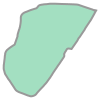

In [192]:
# nyc_gdf.set_index('objectid')
(nyc_gdf.loc[0].at['geometry'])

In [363]:
(nyc_gdf.loc[nyc_gdf['objectid'] == '60'].at['geometry'])

TypeError: DataFrame._get_value() missing 1 required positional argument: 'col'

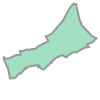

In [392]:
nyc_gdf.loc[nyc_gdf['objectid'] == '84']['geometry'].to_crs(4326).item()

In [459]:
#THIS
nyc_gdf.geometry.to_crs(4326)
zone1_bbox = nyc_gdf.loc[nyc_gdf['objectid'] == '84']['geometry'].item()
g_z1 = ox.graph_from_polygon(zone1_bbox,network_type='drive',retain_all=True)
g_z1 = ox.utils_graph.get_undirected(g_z1)
random_address_z1 = ox.utils_geo.sample_points(g_z1,1).to_crs(4326)
raz1_list = random_address_z1.to_list()
raz1_lat = float((str(raz1_list).split(' '))[1].strip('('))
raz1_lon = float((str(raz1_list).split(' '))[2].strip(')>]'))

/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)


In [460]:
#THIS
zone2_bbox = nyc_gdf.loc[nyc_gdf['objectid'] == '44']['geometry'].item()
g_z2 = ox.graph_from_polygon(zone2_bbox)
g_z2 = ox.utils_graph.get_undirected(g_z2)
random_address_z2 = ox.utils_geo.sample_points(g_z2, 1).to_crs(4326)
raz2_list = random_address_z2.to_list()
raz2_lat = float((str(raz2_list).split(' '))[1].strip('('))
raz2_lon = float((str(raz2_list).split(' '))[2].strip(')>]'))

/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)


<Axes: >

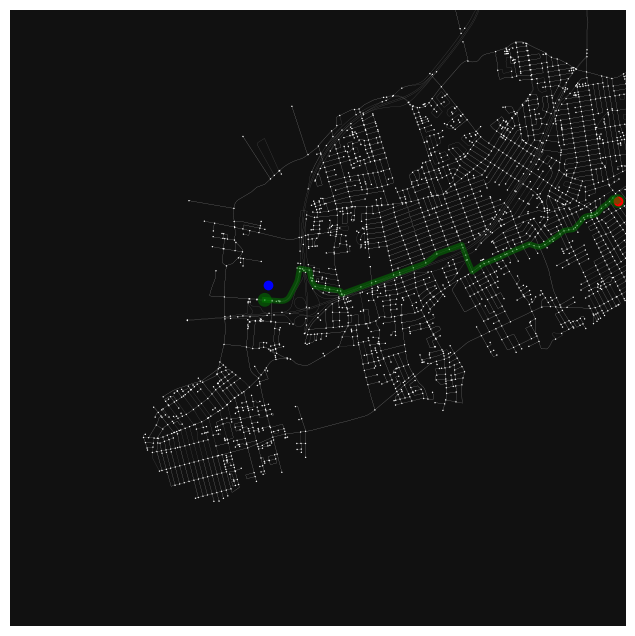

In [495]:
#THIS
g = ox.graph_from_place('New York City, NY, USA', network_type = 'drive')
random_node_z1 = ox.nearest_nodes(g,raz1_lat,raz1_lon)
random_node_z2 = ox.nearest_nodes(g,raz2_lat,raz2_lon)
route = ox.shortest_path(g, random_node_z1, random_node_z2, weight='length')
route_list = [route]

G = nx.compose(g_z1, g_z2).to_undirected()
c = ox.graph_to_gdfs(G, edges=False).unary_union.centroid
bbox = ox.utils_geo.bbox_from_point(point=(c.y, c.x), dist=5000)

fig, ax = ox.plot_graph_route(g, route, 'g', show=False, close=False, node_size=1, node_color='w', edge_color='w', edge_linewidth=0.05,bbox = bbox)


random_address_z1.plot(color = 'r', ax = ax)
random_address_z2.plot(color = 'b', ax = ax)


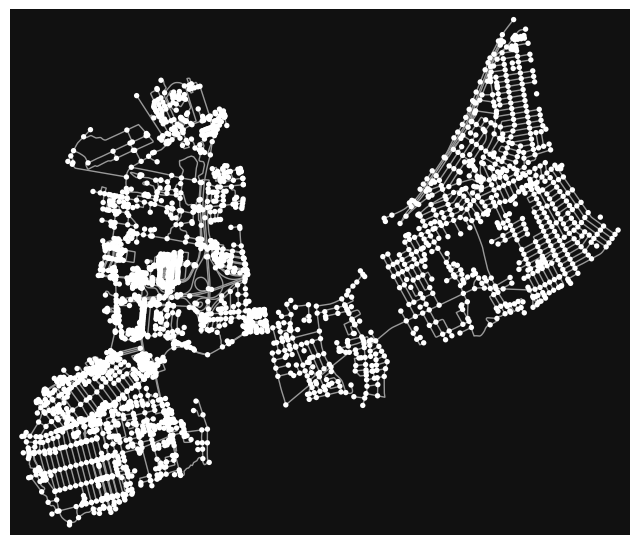

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [481]:
G = nx.compose(g_z1, g_z2).to_undirected()
ox.plot_graph(G)

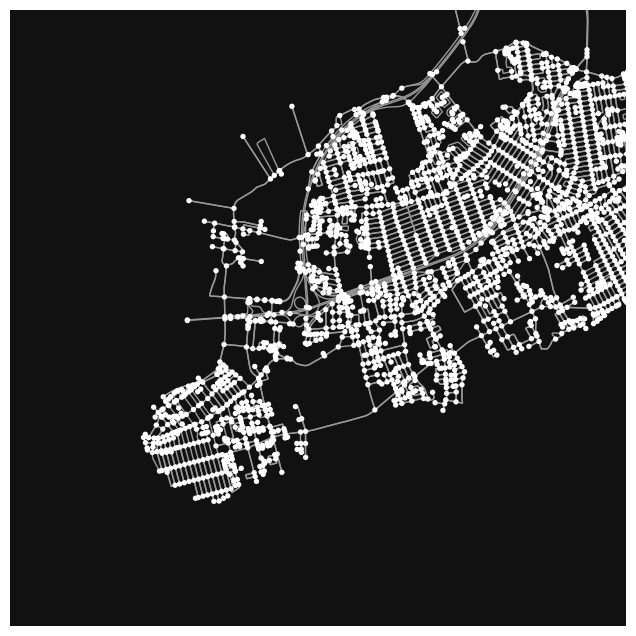

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [492]:
c = ox.graph_to_gdfs(G, edges=False).unary_union.centroid
bbox = ox.utils_geo.bbox_from_point(point=(c.y, c.x), dist=5000)
ox.plot_graph(g, bbox = bbox)

/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:45: UserWarning: graph should be undirected to not oversample bidirectional edges
  warnings.warn("graph should be undirected to not oversample bidirectional edges")
/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)


<Axes: >

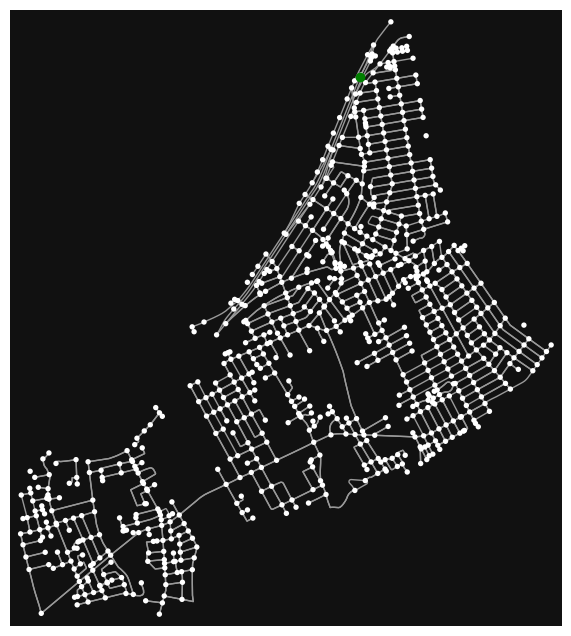

In [368]:
sixty = ox.graph_from_polygon(nyc_gdf.loc[nyc_gdf['objectid'] == '84']['geometry'].item(),network_type='drive',retain_all=True)
fig, ax = ox.plot_graph(sixty, show=False, close=False)
random_address_z2 = ox.utils_geo.sample_points(sixty, 1).to_crs(4326)
random_address_z2.plot(color = 'g',ax = ax)

In [377]:
import networkx as nx
def distance_between_two_zones(gdf:gpd.GeoDataFrame, zone1: int, zone2: int):
    gdf['geometry'] = gdf['geometry'].to_crs(4326)

    zone1_bbox = gdf.loc[gdf['objectid'] == str(zone1)]['geometry'].item()
    g_z1 = ox.graph_from_polygon(zone1_bbox,network_type='drive',retain_all=True)
    g_z1 = ox.utils_graph.get_undirected(g_z1)
    random_address_z1 = ox.utils_geo.sample_points(g_z1,1).to_crs(4326)


    zone2_bbox = gdf.loc[gdf['objectid'] == str(zone2)]['geometry'].item()
    g_z2 = ox.graph_from_polygon(zone2_bbox)
    g_z2 = ox.utils_graph.get_undirected(g_z2)
    random_address_z2 = ox.utils_geo.sample_points(g_z2, 1).to_crs(4326)

    G = nx.compose(g_z1, g_z2)

    fig, ax = ox.plot_graph(G, show=False, close=False)
    random_address_z1.plot(color = 'r',ax= ax)
    random_address_z2.plot(color = 'b', ax= ax)

    g = ox.graph_from_place('New York City, NY, USA',network_type = 'drive')

    paths = ox.distance.shortest_path(G = g,orig=random_address_z1,dest=random_address_z2)
    paths.plot(color = 'p',ax = ax)
    # distance = random_address_z1.distance(random_address_z2)
    # print(distance)
    return paths

In [496]:
# THIS!!!
def plot_routes_for_random_addresses_in_2_zones(gdf:gpd.GeoDataFrame, zone1: int, zone2: int):
    gdf.geometry.to_crs(4326)
    zone1_bbox = gdf.loc[gdf['objectid'] == str(zone1)]['geometry'].item()
    g_z1 = ox.graph_from_polygon(zone1_bbox,network_type='drive',retain_all=True)
    g_z1 = ox.utils_graph.get_undirected(g_z1)
    random_address_z1 = ox.utils_geo.sample_points(g_z1,1).to_crs(4326)
    raz1_list = random_address_z1.to_list()
    raz1_lat = float((str(raz1_list).split(' '))[1].strip('('))
    raz1_lon = float((str(raz1_list).split(' '))[2].strip(')>]'))

    zone2_bbox = gdf.loc[gdf['objectid'] == str(zone2)]['geometry'].item()
    g_z2 = ox.graph_from_polygon(zone2_bbox)
    g_z2 = ox.utils_graph.get_undirected(g_z2)
    random_address_z2 = ox.utils_geo.sample_points(g_z2, 1).to_crs(4326)
    raz2_list = random_address_z2.to_list()
    raz2_lat = float((str(raz2_list).split(' '))[1].strip('('))
    raz2_lon = float((str(raz2_list).split(' '))[2].strip(')>]'))

    g = ox.graph_from_place('New York City, NY, USA', network_type = 'drive')
    random_node_z1 = ox.nearest_nodes(g,raz1_lat,raz1_lon)
    random_node_z2 = ox.nearest_nodes(g,raz2_lat,raz2_lon)
    route = ox.shortest_path(g, random_node_z1, random_node_z2, weight='length')

    G = nx.compose(g_z1, g_z2).to_undirected()
    c = ox.graph_to_gdfs(G, edges=False).unary_union.centroid
    bbox = ox.utils_geo.bbox_from_point(point=(c.y, c.x), dist=5000)

    fig, ax = ox.plot_graph_route(g, route, 'g', show=False, close=False, node_size=1, node_color='w', edge_color='w', edge_linewidth=0.05,bbox = bbox)

    random_address_z1.plot(color = 'r', ax = ax)
    random_address_z2.plot(color = 'b', ax = ax)
    return

/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)
/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)


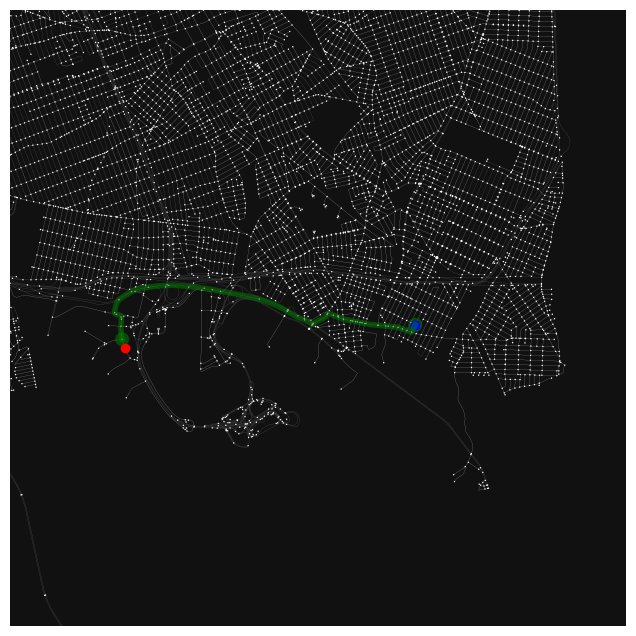

In [497]:
plot_routes_for_random_addresses_in_2_zones(nyc_gdf, 132, 219)

/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)
/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils_geo.py:50: UserWarning: Geometry is in a geographic CRS. Results from 'interpolate' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return lines.interpolate(np.random.rand(n), normalized=True)


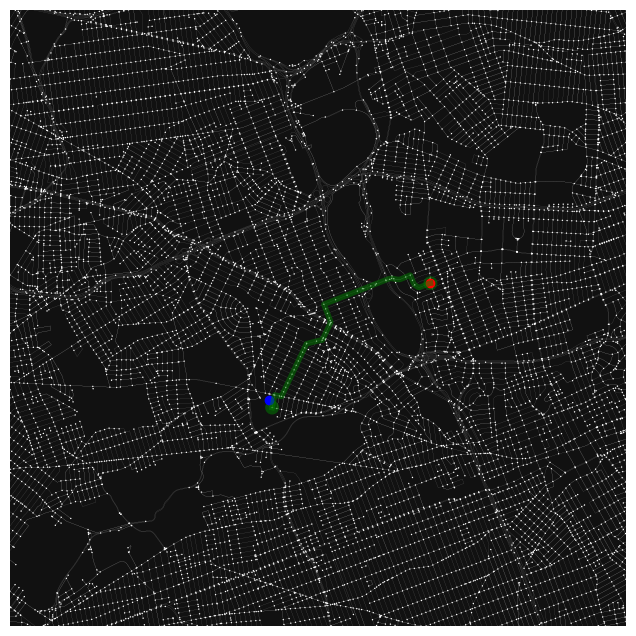

In [498]:
plot_routes_for_random_addresses_in_2_zones(nyc_gdf, 135, 95)

In [329]:
nyc_gdf.explore()

In [234]:
import numpy as np
import osmnx as ox

def sample_points(G, n):
    gdf_edges = ox.graph_to_gdfs(G, nodes=False)[['geometry', 'length']]
    weights = gdf_edges['length'] / gdf_edges['length'].sum()
    idx = np.random.choice(gdf_edges.index, size=n, p=weights)
    lines = gdf_edges.loc[idx, 'geometry']
    return lines.interpolate(lines.length * np.random.rand())

# test the sampler (use a projected graph for most accurate results)
G = ox.project_graph(ox.graph_from_place('Piedmont, CA, USA', network_type='drive'))
points = sample_points(G, 100000)

<Axes: >

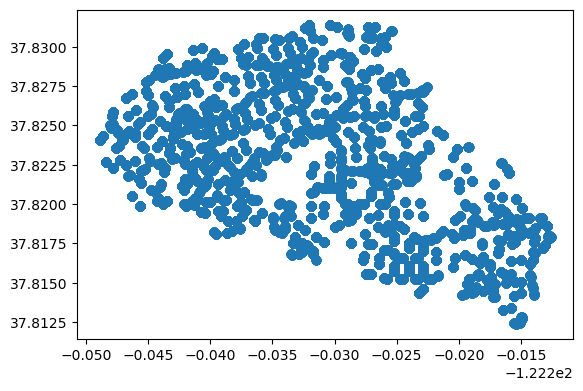

In [278]:
points[53089336,53060462][0].to_crs(4326).reset_index

<Axes: >

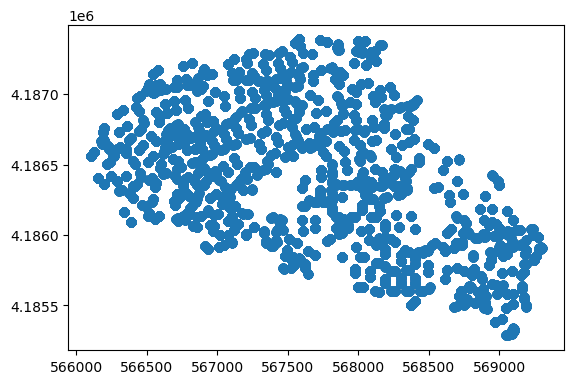

In [293]:
points.plot()

ValueError: setting an array element with a sequence.

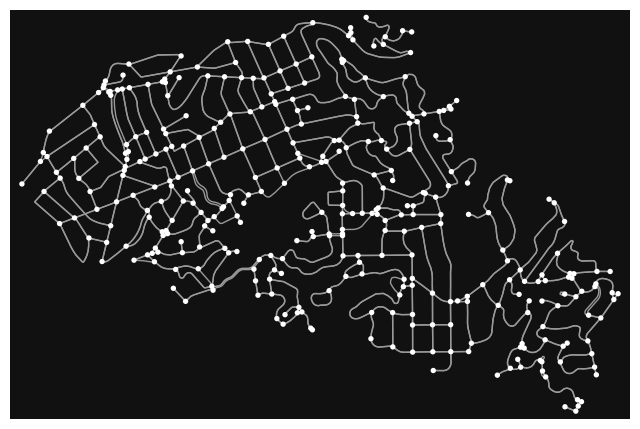

In [292]:
fig, ax = ox.plot_graph(G, show=False, close=False)
ax.plot(points.geometry,color = 'r')

In [501]:
G = ox.project_graph(ox.graph_from_place('Bedford Avenue, NYC', network_type='drive'))

ValueError: Nominatim could not geocode query "Bedford Avenue, NYC" to polygonal boundaries

# ROAD CLOSURE GEOMETRY

In [3]:
street_closures = pd.read_csv('2018-street-closures_corrected_names.csv')

In [0]:
#https://stackoverflow.com/questions/56433138/converting-a-column-of-polygons-from-string-to-geopandas-geometry/56433910#56433910

roads = gpd.read_file('roads_geo.csv')
roads['geometry'] = gpd.GeoSeries.from_wkt(roads['geo'])
my_geo_df = gpd.GeoDataFrame(roads, geometry='geometry', crs="EPSG:4326")

In [19]:
roads_gdf = my_geo_df.set_index('stname_lab')

In [14]:
unique_roads = [roads_gdf.index.unique()][0]
print(len(unique_roads))


10406


In [22]:
roads_gdf = roads_gdf.reset_index()[['stname_lab','geometry']]
roads_gdf

,stname_lab,geometry
0,3 AV,"LINESTRING (-73.98027 40.68596, -73.98070 40.6..."
1,GRAND CENTRAL PKWY,"LINESTRING (-73.84554 40.73966, -73.84537 40.7..."
2,WASHINGTON AV,"LINESTRING (-73.96582 40.68821, -73.96553 40.6..."
3,ROCKAWAY BEACH BLVD,"LINESTRING (-73.85196 40.57428, -73.85275 40.5..."
4,94 ST,"LINESTRING (-73.86925 40.74057, -73.86899 40.7..."
...,...,...
117186,CONNECTOR,"LINESTRING (-74.18394 40.61037, -74.18397 40.6..."
117187,BEACH 12 ST,"LINESTRING (-73.74621 40.59624, -73.74621 40.5..."
117188,CHAPIN AV,"LINESTRING (-74.10130 40.59708, -74.10189 40.5..."
117189,LONG ISLAND EXPY,"LINESTRING (-73.86444 40.73393, -73.86342 40.7..."


AttributeError: 'GeoSeries' object has no attribute 'columns'

In [40]:
road_dict = {}
for road in unique_roads:
    # print(road)
    road_list_of_lines = []
    # print((roads_gdf.loc[roads_gdf['stname_lab'] == road])['geometry'].index)
    for x in (roads_gdf.loc[roads_gdf['stname_lab'] == road])['geometry']:
        print(x)
        # print((roads_gdf.loc[roads_gdf.index == x]['geometry']))
        # print(type(roads_gdf.loc[roads_gdf.index == x]['geometry']))
        road_list_of_lines.append(x)
    # print(road_list_of_lines)
    road_dict[road] = road_list_of_lines
road_dict

LINESTRING (-73.98027180261785 40.6859582541996, -73.98070142727599 40.68532362715469)
LINESTRING (-73.98040998073928 40.74258716037545, -73.97995899751066 40.74320520013231)
LINESTRING (-74.03386577352411 40.61659397130616, -74.03389978866599 40.61651131124679)
LINESTRING (-73.97444451625712 40.75076469249241, -73.97395914727245 40.75144102077484)
LINESTRING (-73.89077428610123 40.85581193980978, -73.89108676574621 40.856597256545)
LINESTRING (-73.94607668694383 40.78964885915515, -73.94600536786095 40.78974687370709, -73.9459864047311 40.78977293474871, -73.94563352428045 40.79025310895507)
LINESTRING (-73.96802436981947 40.75957814005301, -73.96788219741684 40.759578406908254, -73.96742588496245 40.760207605146434)
LINESTRING (-74.01207536268547 40.64981151625663, -74.01266264860631 40.64925555478156)
LINESTRING (-73.89111115373557 40.85838432205346, -73.8911194330454 40.85865896190922)
LINESTRING (-73.92941937812537 40.80926430381325, -73.92933467470218 40.80934222610327)
LINESTRIN

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



LINESTRING (-73.80792714625807 40.70176553341759, -73.80698842476906 40.701769978516886)
LINESTRING (-73.72568222878132 40.72406423923026, -73.72506845031899 40.72424712826303)
LINESTRING (-73.75401024530721 40.713834900877075, -73.753955978178 40.71384902190481, -73.75309472579045 40.71405233276541)
LINESTRING (-73.78056180986164 40.70846563607761, -73.78020196732595 40.70853632685085, -73.77970067972637 40.70863480073132)
LINESTRING (-73.7786431457203 40.70873449373152, -73.77814904529795 40.70881100494482)
LINESTRING (-73.85323418818972 40.69326422214421, -73.85239770035732 40.69357491086456)
LINESTRING (-73.7364429698603 40.71809794130777, -73.73615787541377 40.71821823603)
LINESTRING (-73.7648754320411 40.71332073627719, -73.76402206536336 40.71336400650597)
LINESTRING (-73.76803486897664 40.71289684414097, -73.76784844279176 40.71298778090738, -73.76765362609896 40.71306835259613, -73.76745195958918 40.713137951304155)
LINESTRING (-73.76859582633935 40.71248716807477, -73.7679830

{'3 AV': [<LINESTRING (-73.98 40.686, -73.981 40.685)>,
  <LINESTRING (-73.98 40.743, -73.98 40.743)>,
  <LINESTRING (-74.034 40.617, -74.034 40.617)>,
  <LINESTRING (-73.974 40.751, -73.974 40.751)>,
  <LINESTRING (-73.891 40.856, -73.891 40.857)>,
  <LINESTRING (-73.946 40.79, -73.946 40.79, -73.946 40.79, -73.946 40.79)>,
  <LINESTRING (-73.968 40.76, -73.968 40.76, -73.967 40.76)>,
  <LINESTRING (-74.012 40.65, -74.013 40.649)>,
  <LINESTRING (-73.891 40.858, -73.891 40.859)>,
  <LINESTRING (-73.929 40.809, -73.929 40.809)>,
  <LINESTRING (-73.965 40.764, -73.964 40.765)>,
  <LINESTRING (-73.902 40.837, -73.902 40.837, -73.902 40.837, -73.902 40.837,...>,
  <LINESTRING (-73.966 40.762, -73.966 40.763)>,
  <LINESTRING (-74.027 40.633, -74.028 40.632)>,
  <LINESTRING (-73.969 40.758, -73.968 40.759)>,
  <LINESTRING (-73.909 40.824, -73.908 40.825)>,
  <LINESTRING (-73.82 40.797, -73.819 40.797)>,
  <LINESTRING (-74.032 40.622, -74.032 40.621)>,
  <LINESTRING (-73.945 40.792, -73.944 

In [208]:
g = ox.graph_from_place('NYC, NY, USA', network_type='drive')
g_gdf = ox.graph_to_gdfs(g,nodes=False, edges=True, node_geometry=False, fill_edge_geometry=False)
# fig, ax = ox.plot_graph(g, node_size=1, node_color='w', edge_color='w', edge_linewidth=0.05)

In [248]:
nyc = g_gdf

In [254]:
nyc = nyc[~nyc['name'].apply(lambda x: isinstance(x, list))]

In [256]:
import pandas as pd
import re

# create sample dataframe
# define function to remove suffix from street name
def remove_suffix(name):
    # check if value is a string
    if isinstance(name, str):
        # apply regular expression to remove suffix
        return re.sub(r'(?<=\d)(st|nd|rd|th)\b', '', name)
    # if value is not a string or is NaN, return NaN
    else:
        return np.nan

# apply function to 'name' column and overwrite existing values
nyc['name'] = nyc['name'].apply(remove_suffix)

In [266]:
nyc[['name','geometry']].dropna().to_csv('street_geometries.csv')

In [261]:
nyc.to_csv('street_geometries.csv')

u           v           key
42423020    42434965    0      LINESTRING (-73.97497 40.74609, -73.97502 40.7...
42424089    42442961    0      LINESTRING (-73.96436 40.76062, -73.96440 40.7...
42429340    42443037    0      LINESTRING (-73.95174 40.77788, -73.95181 40.7...
42429693    42443000    0      LINESTRING (-73.95934 40.76750, -73.95938 40.7...
42429900    42442891    0      LINESTRING (-73.97953 40.73979, -73.97957 40.7...
                                                     ...                        
7925143983  3931534871  0      LINESTRING (-73.93434 40.80137, -73.93439 40.8...
8132470015  42496182    0      LINESTRING (-73.99439 40.67140, -73.99484 40.6...
            42496175    0      LINESTRING (-73.99439 40.67140, -73.99393 40.6...
9924890061  42496120    0                                                   None
            42496133    0      LINESTRING (-74.00644 40.65918, -74.00617 40.6...
Name: geometry, Length: 245, dtype: geometry


Text(0.5, 1.0, '2nd Avenue Outlined on Zone Map with Street View')

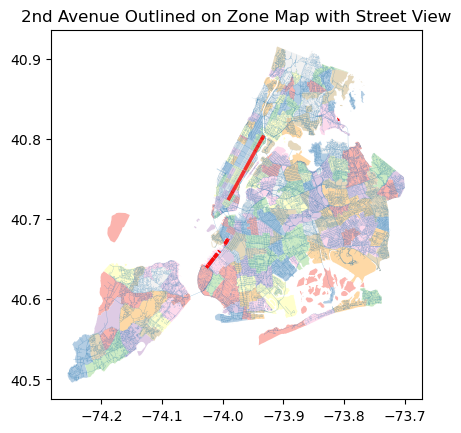

In [265]:
ax = nyc.geometry.plot(linewidth = 0.05)
nyc_gdf.plot(ax = ax,cmap = 'Pastel1',linewidth = .2)

sec_ave = nyc.loc[nyc['name'] == '2 Avenue'].geometry
print(sec_ave)
sec_ave.plot(color = 'r', ax = ax, linewidth = 2.5,linestyle = '--')
ax.set_title('2nd Avenue Outlined on Zone Map with Street View')

In [159]:
# nyc[['name','geometry']].loc[nyc['name']=='Broadway'].plot()
ox.graph_from_gdfs(g_gdf[0], gdf_edges = nyc[nyc['name']=='Broadway']['geometry'])

AttributeError: 'GeoSeries' object has no attribute 'columns'

In [161]:
ox.graph_from_gdfs(g_gdf[0])

TypeError: graph_from_gdfs() missing 1 required positional argument: 'gdf_edges'

In [114]:
(g_gdf)[0].join(g_gdf[1],'osmid')

ValueError: len(left_on) must equal the number of levels in the index of "right"

In [74]:
Broadway_gdf = gpd.GeoDataFrame(road_dict['BROADWAY'], geometry=0, crs="EPSG:4326")

LINESTRING (-73.94778083851676 40.830263780459234, -73.94732595299794 40.83088799495883)
LINESTRING (-73.9881770997451 40.748288822226975, -73.98803809971338 40.74902299954799)
LINESTRING (-73.96121351209844 40.81188015715425, -73.96076765977566 40.81250554539546, -73.96028723472503 40.81315468765471, -73.95979225990001 40.81382347440073)
LINESTRING (-73.94315435768307 40.836600406947966, -73.94269535680036 40.837221854142214)
LINESTRING (-73.93739064765448 40.69818579539983, -73.93675979026746 40.697831188830506)
LINESTRING (-73.94386850665944 40.835267260235945, -73.94341184343135 40.835890188107605)
LINESTRING (-73.91878323293797 40.68762608794119, -73.91829345832642 40.687356667815266)
LINESTRING (-74.01194691411979 40.70745153141393, -74.01170249917278 40.70775571315629)
LINESTRING (-73.95590649043288 40.818752022404084, -73.95545008463124 40.81937683690409)
LINESTRING (-73.98321466986047 40.76270716796823, -73.98281763066758 40.76336492809364)
LINESTRING (-73.9347969968421 40.696

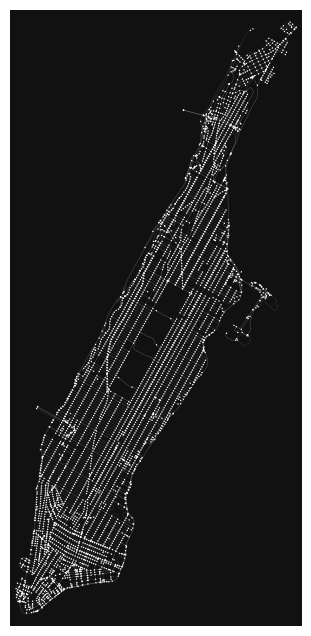

<Axes: >

<Figure size 640x480 with 0 Axes>

In [83]:
fig, ax = ox.plot_graph(g, node_size=1, node_color='w', edge_color='w', edge_linewidth=0.05)
Broadway_gdf.plot(ax = ax,color='r',linewidth = 3)

In [606]:
roads

,rw_type,rwjurisdic,continuous,created_by,l_low_hn,modified_b,bphys_id,rsubsect,collection,twisted_pa,...,boroughcod,posted_spe,trafdir,l_blockfac,physicalid,borough_in,accessible,truck_rout,l_high_hn,geometry
stname_lab,,,,,,,,,,,,,,,,,,,,,
3 AV,1,NaN,NaN,DCP,25,csarkissian,0,2K,NaN,N,...,3,0,TF,0,37785,NaN,NaN,NaN,43,"LINESTRING (-73.98027 40.68596, -73.98070 40.6..."
GRAND CENTRAL PKWY,2,NaN,NaN,CSCL,NaN,BlockfaceID_LOAD,0,1D,NaN,N,...,4,0,FT,92260988,7141,NaN,NaN,NaN,NaN,"LINESTRING (-73.84554 40.73966, -73.84537 40.7..."
WASHINGTON AV,1,NaN,NaN,DCP,349,csarkissian,0,3A,NaN,N,...,3,0,TW,0,38225,NaN,NaN,NaN,393,"LINESTRING (-73.96582 40.68821, -73.96553 40.6..."
ROCKAWAY BEACH BLVD,1,NaN,NaN,O_Ortiz,134-001,BlockfaceID_LOAD,0,1C,NaN,N,...,4,0,TF,12261266,166986,NaN,NaN,NaN,134-099,"LINESTRING (-73.85196 40.57428, -73.85275 40.5..."
94 ST,1,NaN,NaN,DCP,51-001,BlockfaceID_LOAD,0,2C,NaN,N,...,4,0,TW,92263852,97055,NaN,NaN,NaN,51-099,"LINESTRING (-73.86925 40.74057, -73.86899 40.7..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CONNECTOR,1,NaN,NaN,V_Bogdan,NaN,BlockfaceID_LOAD,0,4E,NaN,N,...,5,0,TW,0,163855,NaN,NaN,NaN,NaN,"LINESTRING (-74.18394 40.61037, -74.18397 40.6..."
BEACH 12 ST,1,NaN,NaN,DCP,201,BlockfaceID_LOAD,0,3C,F,N,...,4,0,TF,12263306,16160,NaN,NaN,NaN,299,"LINESTRING (-73.74621 40.59624, -73.74621 40.5..."
CHAPIN AV,1,NaN,NaN,DCP,80,BlockfaceID_LOAD,0,3D,NaN,N,...,5,0,TW,1622604433,54261,NaN,NaN,NaN,108,"LINESTRING (-74.10130 40.59708, -74.10189 40.5..."


In [607]:
roads['geometry'].to_csv('roads_geo.csv')

In [614]:
roads = gpd.read_file('roads_geo.csv')
# roads.set_geometry('geo',inplace=True)

In [620]:
roads_gdf = my_geo_df.set_index('stname_lab')['geometry']

In [624]:
unique_roads = [roads_gdf.index.unique()]

In [626]:
unique_roads
roads_gdf = roads_gdf.reset_index()


[Index(['3 AV', 'GRAND CENTRAL PKWY', 'WASHINGTON AV', 'ROCKAWAY BEACH BLVD',
        '94 ST', '133 AV', 'E WILLISTON AV', 'BIKE PATH', 'CONNECTOR', '137 ST',
        ...
        'SILVER CT', 'WAGNER ST', 'HILLTOP PL', 'LINCOLN TER',
        'GCP WB EN FRANCIS LEWIS BLVD SB', 'MC KENNA SQ', 'TRACY AV',
        'SHERIDAN PL', 'HRP NB EN WILKINSON AV', 'STRONG PL'],
       dtype='object', name='stname_lab', length=10658)]

In [62]:
import matplotlib.pyplot as plt
from descartes import PolygonPatch
from shapely.geometry import Polygon, MultiPolygon
import osmnx as ox
ox.config(log_console=True, use_cache=True)
ox.__version__

def plot(geometries):
  # get the place shape
  gdf = ox.gdf_from_place('Manhattan,NY,USA')
  gdf = ox.project_gdf(gdf)

  # get the street network, with retain_all=True to retain all the disconnected islands' networks
  G = ox.graph_from_place('Copenhagen Municipality,Denmark', network_type='drive', retain_all=True)
  G = ox.project_graph(G)

  fig, ax = ox.plot_graph(G, fig_height=10, show=False, close=False, edge_color='#777777')

  # Add shape from gdf
  for geometry in gdf['geometry'].tolist():
    if isinstance(geometry, (Polygon, MultiPolygon)):
      if isinstance(geometry, Polygon):
        geometry = MultiPolygon([geometry])
      for polygon in geometry:
        patch = PolygonPatch(polygon, fc='#cccccc', ec='k', linewidth=3, alpha=0.1, zorder=-1)
        ax.add_patch(patch)

  # Add lines:
  for geometry in geometries:
    if isinstance(geometry, (Polygon, MultiPolygon)):
      if isinstance(geometry, Polygon):
        geometry = MultiPolygon([geometry])
        for polygon in geometry:
          patch = PolygonPatch(polygon, fc='#148024', ec='#777777', linewidth=10, alpha=1, zorder=2)
          ax.add_patch(patch)

  plt.savefig('images/cph.png', alpha=True, dpi=300)

plot(geometries)

/Users/tzacks2/.conda/envs/DataViz/lib/python3.10/site-packages/osmnx/utils.py:192: UserWarning: The `utils.config` function is deprecated and will be removed in a future release. Instead, use the `settings` module directly to configure a global setting's value. For example, `ox.settings.log_console=True`.
  warnings.warn(


NameError: name 'geometries' is not defined

<Axes: >

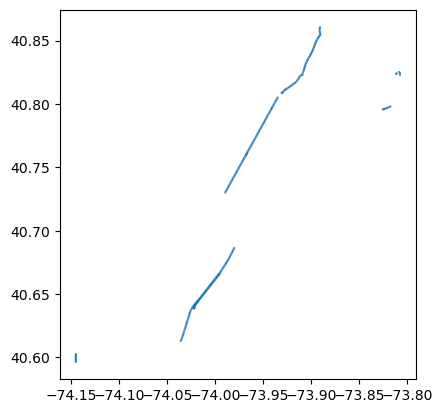

In [32]:
roads_gdf.loc[roads_gdf['stname_lab']=='3 AV'].plot()

In [640]:
(roads_gdf.loc[roads_gdf['stname_lab'] == 'BEDFORD AV']).index

Int64Index([  1313,   1588,   1792,   3146,   3516,   3986,   5252,   5758,
              5899,   6101,
            ...
            111813, 113646, 113917, 113965, 114842, 115363, 115606, 115670,
            116568, 116879],
           dtype='int64', length=175)

In [644]:
for road in unique_roads[0]:
    print(road)

3 AV
GRAND CENTRAL PKWY
WASHINGTON AV
ROCKAWAY BEACH BLVD
94 ST
133 AV
E WILLISTON AV
BIKE PATH
CONNECTOR
137 ST
191 ST
84 ST
PARK DR
W 17 ST
RICHMOND RD
NEWHALL AV
E 19 ST
CROSS ISLE PKWY SR N
GRAND ST
BRADFORD ST
WESTBROOK AV
ALASKA ST
E 60 ST
150 ST
W 230 ST
INDEPENDENCE AV
ROME AV
VANDERBILT ST
ALLEY
HIMROD ST
VICTORY BLVD
CHURCH AV
CENTRE ST
VANDERBILT AV
QUEENS BLVD
WATER ST
E 12 ST
DUFFIELD ST
CENTRAL PARK GR HILL
AV U
BRONX RIVER GREENWAY
DAYLILY/DAFFODIL WALK
SCHOLES ST
OCEAN PKWY
155 ST
HARMAN ST
MANOR RD
BOND ST
AV P
41 AV
43 AV
186 ST
BQE
ARBUTUS AV
SURF AV
17 AV
GENESEE AV
HALLECK ST
53 AV
BROADWAY
CANTON AV
E 51 ST
THOMPSON ST
POWELL AV
HASPEL ST
53 ST
WADSWORTH AV
GLENMORE AV
AQUATIC DR
19 AV
EASTCHESTER RD
LACONIA AV
CO-OP CITY BLVD
144 DR
VOORHIES AV
BAYCHESTER AV
BERGEN CT
260 ST
SURF DR
WEINER ST
61 AV
DREW ST
MADISON AV BR
LEONARD ST
120 ST
VERMONT PL
EXCHANGE PL
118 AV
EVERGREEN AV
BROOKLYN QUEENS EXWY
BQE W
MC CLELLAN ST
100 ST
163 ST
CROSS BRONX EXWY
HANCOCK ST
F

In [667]:
road_dict = {}
for road in unique_roads[0]:
    # print(road)
    road_list_of_lines = []
    # print((roads_gdf.loc[roads_gdf['stname_lab'] == road])['geometry'].index)
    for x in (roads_gdf.loc[roads_gdf['stname_lab'] == road])['geometry'].index:
        print((roads_gdf.loc[roads_gdf.index == x]['geometry']))
        # road_list_of_lines.append(roads_gdf[roads_gdf.index == x]['geometry'])
    # print(road_list_of_lines)
    road_dict[road] = road_list_of_lines
road_dict

  stname_lab                                           geometry
0       3 AV  LINESTRING (-73.98027 40.68596, -73.98070 40.6...
    stname_lab                                           geometry
590       3 AV  LINESTRING (-73.98041 40.74259, -73.97996 40.7...
    stname_lab                                           geometry
730       3 AV  LINESTRING (-74.03387 40.61659, -74.03390 40.6...
     stname_lab                                           geometry
1089       3 AV  LINESTRING (-73.97444 40.75076, -73.97396 40.7...
     stname_lab                                           geometry
1760       3 AV  LINESTRING (-73.89077 40.85581, -73.89109 40.8...
     stname_lab                                           geometry
1948       3 AV  LINESTRING (-73.94608 40.78965, -73.94601 40.7...
     stname_lab                                           geometry
2002       3 AV  LINESTRING (-73.96802 40.75958, -73.96788 40.7...
     stname_lab                                           geometry
2215 

KeyboardInterrupt: 

In [669]:
road_dict

{}

In [592]:
d = {'geometry': bedford}

gdf = gpd.GeoDataFrame(d, crs="EPSG:4326")

gdf

,geometry
0,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
1,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
2,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
3,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
4,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
...,...
170,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
171,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
172,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
173,"LINESTRING (-73.96433 40.70801, -73.96438 40.7..."
